# **<center>Video Classification and Human Activity Recognition</center>**




---



---



**Here are the steps we will perform:**

- **Step 1: Download and Extract the Dataset**
- **Step 2: Visualize the Data with its Labels**
- **Step 3: Read and Preprocess the Dataset**
- **Step 4: Split the Data into Train and Test Set**
- **Step 5: Construct the Model**
- **Step 6: Compile & Train the Model**
- **Step 7: Plot Model’s Loss & Accuracy Curves**
- **Step 8: Make Predictions with the Model**
- **Step 9: Using Single-Frame CNN Method**

Installing Pafy, youtube-dl and moviepy packages installed.

**Pafy library**:
It is used to retrieve YouTube content and metadata.

***Features of Pafy***

* Retreive metadata such as viewcount, duration, rating, author, thumbnail, keywords
* Download video or audio at requested resolution / bitrate / format / filesize
* Command line tool (ytdl) for downloading directly from the command line
* Retrieve the URL to stream the video in a player such as vlc or mplayer
* Works with age-restricted videos and non-embeddable videos
* Small, standalone, single importable module file (pafy.py)
* Select highest quality stream for download or streaming
* Download video only (no audio) in m4v or webm format
* Download audio only (no video) in ogg or m4a format
* Retreive playlists and playlist metadata
* Works with Python 2.6+ and 3.3+
* Optionally depends on youtube-dl

**Youtube-dl**

youtube-dl is a command-line program to download videos from YouTube.com and a few more sites. It requires the Python interpreter, version 2.6, 2.7, or 3.2+, and it is not platform specific. It is a free and open source download manager for video and audio from YouTube and over 1,000 other video hosting websites.

**moviepy**

MoviePy is a Python module for video editing, which can be used for basic operations (like cuts, concatenations, title insertions), video compositing (a.k.a. non-linear editing), video processing, or to create advanced effects. It can read and write the most common video formats, including GIF.


In [ ]:
!pip install pafy youtube-dl moviepy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 19.7 MB/s eta 0:00:00


#### **Importing Necessary Libraries:**


In [ ]:
import os
import cv2
import math
import pafy
import random
import numpy as np
import datetime as dt
import tensorflow as tf
from moviepy.editor import *
from collections import deque
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.model_selection import train_test_split

from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model

**Using Numpy, Python & Tensorflow seeds to get consistent results.**

In [ ]:
seed_constant = 23
np.random.seed(seed_constant)
random.seed(seed_constant)
tf.random.set_seed(seed_constant)

## **Download and Extract the Dataset**

Downloading the dataset

The Dataset we are using is the [UCF50 - Action Recognition Dataset](https://www.crcv.ucf.edu/data/UCF50.php).

**UCF50** is an action recognition dataset which contains:

*   **50** Action Categories consisting of realistic YouTube videos
*   **25** Groups of Videos per Action Category
*   **133** Average Videos per Action Category
*   **199** Average Number of Frames per Video
*   **320** Average Frames Width per Video
*   **240** Average Frames Height per Video
*   **26** Average Frames Per Seconds per Video


In [ ]:
!wget -nc --no-check-certificate https://www.crcv.ucf.edu/data/UCF50.rar
!unrar x UCF50.rar -inul -y

--2024-05-21 10:22:43--  https://www.crcv.ucf.edu/data/UCF50.rar
Resolving www.crcv.ucf.edu (www.crcv.ucf.edu)... 132.170.214.127
Connecting to www.crcv.ucf.edu (www.crcv.ucf.edu)|132.170.214.127|:443... connected.
  Unable to locally verify the issuer's authority.
HTTP request sent, awaiting response... 200 OK
Length: 3233554570 (3.0G) [application/rar]
Saving to: ‘UCF50.rar’

UCF50.rar           100%[===================>]   3.01G  26.1MB/s    in 1m 57s  

2024-05-21 10:24:41 (26.4 MB/s) - ‘UCF50.rar’ saved [3233554570/3233554570]



## **Visualize the Data with its Labels**
Let's pick some random videos from each class of the dataset and display it to understand the nature of the dataset

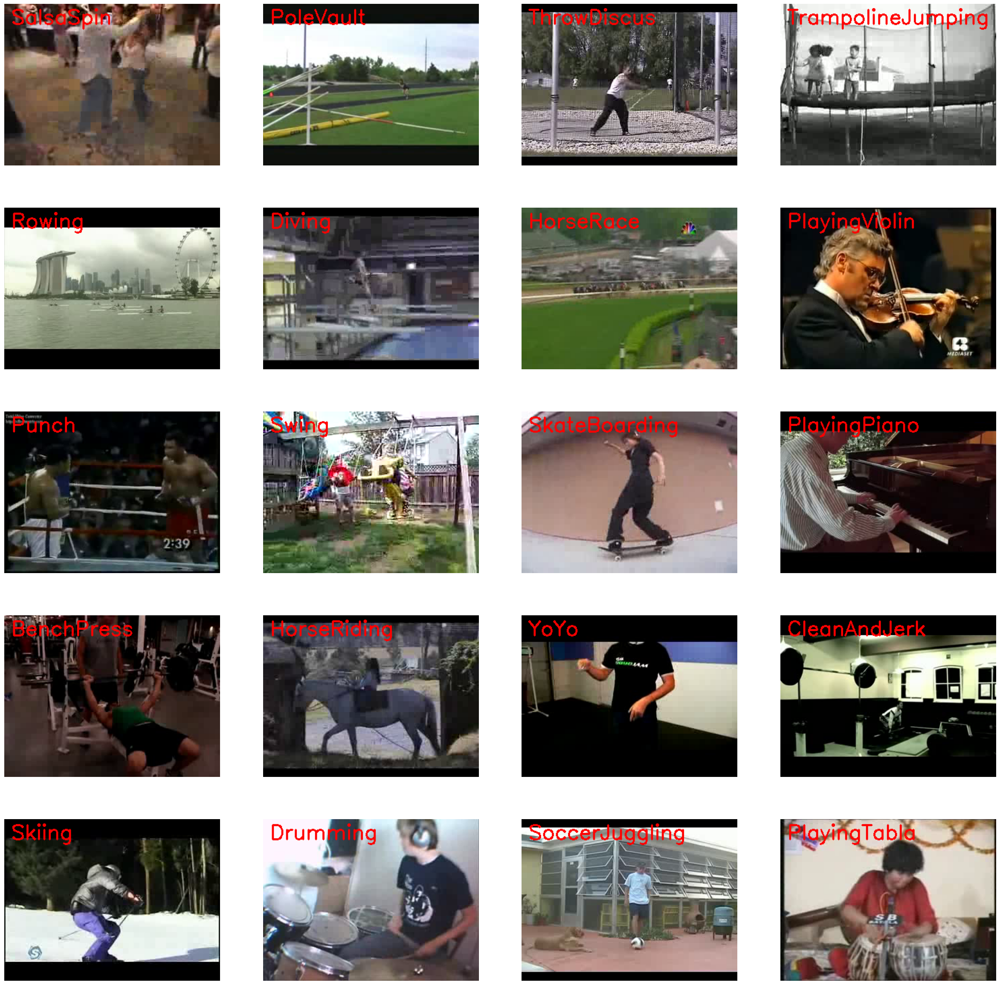

In [ ]:
# Create a Matplotlib figure
plt.figure(figsize = (30, 30))

# Get Names of all classes in UCF50
all_classes_names = os.listdir('UCF50')

# Generate a random sample of images each time the cell runs
random_range = random.sample(range(len(all_classes_names)), 20)

# Iterating through all the random samples
for counter, random_index in enumerate(random_range, 1):

    # Getting Class Name using Random Index
    selected_class_Name = all_classes_names[random_index]

    # Getting a list of all the video files present in a Class Directory
    video_files_names_list = os.listdir(f'UCF50/{selected_class_Name}')

    # Randomly selecting a video file
    selected_video_file_name = random.choice(video_files_names_list)

    # Reading the Video File Using the Video Capture
    video_reader = cv2.VideoCapture(f'UCF50/{selected_class_Name}/{selected_video_file_name}')

    # Reading The First Frame of the Video File
    _, bgr_frame = video_reader.read()

    # Closing the VideoCapture object and releasing all resources.
    video_reader.release()

    # Converting the BGR Frame to RGB Frame
    rgb_frame = cv2.cvtColor(bgr_frame, cv2.COLOR_BGR2RGB)

    # Adding The Class Name Text on top of the Video Frame.
    cv2.putText(rgb_frame, selected_class_Name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)

    # Assigning the Frame to a specific position of a subplot
    plt.subplot(5, 4, counter)
    plt.imshow(rgb_frame)
    plt.axis('off')

## **Read & Preprocess the Dataset**

Since we're going to use a classification architecture to train on a video classification dataset, we're goiing to need to preprocess the dataset first.

Now w constants,
- **`image_height`** and **`image_weight`**: This is the size we will resize all frames of the video to, we're doing this to avoid unneccsary computation.

- **`max_images_per_class`**: Maximum number of training images allowed for each class.

- **`dataset_directory`**: The path of the directory containing the extracted dataset.

- **`classes_list`**: These are the list of classes we're going to be training on, we're traninng on following 4 classes
  - *tai chi*
  - *Swinging*
  - *Horse Racing*
  - *Walking with a Dog*

**Note:** The `image_height`, `image_weight` and `max_images_per_class` constants may be increased for better results, but be warned this will become computationally expensive.

In [ ]:
image_height, image_width = 64, 64
max_images_per_class = 8000

dataset_directory = "UCF50"
classes_list = ["WalkingWithDog", "TaiChi", "Swing", "HorseRace"]

model_output_size = len(classes_list)

### **Extract, Resize & Normalize Frames**


Now we'll create a function that will extract frames from each video while performing other preprocessing operation like resizing and normalizing images.

This method takes a video file path as input. It then reads the video file frame by frame, resizes each frame, normalizes the resized frame, appends the normalized frame into a list and then finally returns that list.

In [ ]:
def frames_extraction(video_path):
    # Empty List declared to store video frames
    frames_list = []

    # Reading the Video File Using the VideoCapture
    video_reader = cv2.VideoCapture(video_path)

    # Iterating through Video Frames
    while True:

        # Reading a frame from the video file
        success, frame = video_reader.read()

        # If Video frame was not successfully read then break the loop
        if not success:
            break

        # Resize the Frame to fixed Dimensions
        resized_frame = cv2.resize(frame, (image_height, image_width))

        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1
        normalized_frame = resized_frame / 255

        # Appending the normalized frame into the frames list
        frames_list.append(normalized_frame)

    # Closing the VideoCapture object and releasing all resources.
    video_reader.release()

    # returning the frames list
    return frames_list

### **Dataset Creation**
Now we'll create another function called  **`create_dataset()`**,  this function uses the **`frame_extraction()`** funciton above and creates our final preprocessed dataset.

**Here's how this function works:**

1.   Iterate through all the classes mentioned in the `classes_list`
2.   Now for each class iterate through all the video files present in it.
3.   Call the **frame_extraction** method on each video file.
4.   Add the returned frames to a list called `temp_features`
5.   After all videos of a class are processed, randomly select video frames (equal to **max_images_per_class**) and add them to the list called `features`.
6.   Add labels of the selected videos to the labels list.
7.   After all videos of all classes are processed then return the features and labels as numpy arrays.


So when you call this function, it returns **2** lists:
- a list of feature vectors
- a list of it's associated labels.


In [ ]:
def create_dataset():

    # Declaring Empty Lists to store the features and labels values.
    temp_features = []
    features = []
    labels = []

    # Iterating through all the classes mentioned in the classes list
    for class_index, class_name in enumerate(classes_list):
        print(f'Extracting Data of Class: {class_name}')

        # Getting the list of video files present in the specific class name directory
        files_list = os.listdir(os.path.join(dataset_directory, class_name))

        # Iterating through all the files present in the files list
        for file_name in files_list:

            # Construct the complete video path
            video_file_path = os.path.join(dataset_directory, class_name, file_name)

            # Calling the frame_extraction method for every video file path
            frames = frames_extraction(video_file_path)

            # Appending the frames to a temporary list.
            temp_features.extend(frames)

        # Adding randomly selected frames to the features list
        features.extend(random.sample(temp_features, max_images_per_class))

        # Adding Fixed number of labels to the labels list
        labels.extend([class_index] * max_images_per_class)

        # Emptying the temp_features list so it can be reused to store all frames of the next class.
        temp_features.clear()

    # Converting the features and labels lists to numpy arrays
    features = np.asarray(features)
    labels = np.array(labels)

    return features, labels

Calling the **create_dataset** method which returns features and labels.

In [ ]:
features, labels = create_dataset()

Extracting Data of Class: WalkingWithDog
Extracting Data of Class: TaiChi
Extracting Data of Class: Swing
Extracting Data of Class: HorseRace


Now we will convert class labels to one hot encoded vectors.

In [ ]:
# Using Keras's to_categorical method to convert labels into one-hot-encoded vectors
one_hot_encoded_labels = to_categorical(labels)

## **Split the Data into Train and Test Set**
Now we have 2 numpy arrays, one containing all images, the second one contains all class labels in one hot encoded format. Let’s split our data to create a training and a testing set. It’s important that you shuffle your data before the split which we have already done.


In [ ]:
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.2, shuffle = True, random_state = seed_constant)

## **Construct the Model**
we're creating a simple CNN Classification model with two CNN layers.

In [ ]:
# Let's create a function that will construct our model
def create_model():

    # We will use a Sequential model for model construction
    model = Sequential()

    # Defining The Model Architecture
    model.add(Conv2D(filters = 64, kernel_size = (3, 3), activation = 'relu', input_shape = (image_height, image_width, 3)))
    model.add(Conv2D(filters = 64, kernel_size = (3, 3), activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size = (2, 2)))
    model.add(GlobalAveragePooling2D())
    model.add(Dense(256, activation = 'relu'))
    model.add(BatchNormalization())
    model.add(Dense(model_output_size, activation = 'softmax'))

    # Printing the models summary
    model.summary()

    return model


# Calling the create_model method
model = create_model()

print("Model Created Successfully!")

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 62, 62, 64)        1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 60, 60, 64)        36928     
                                                                 
 batch_normalization (Batch  (None, 60, 60, 64)        256       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 30, 30, 64)        0         
 D)                                                              
                                                                 
 global_average_pooling2d (  (None, 64)                0         
 GlobalAveragePooling2D)                                         
                                                        

### **Check Model’s Structure:**
Using the **plot_model** function you can check the structure of the final model, this is really helpful when you’re creating a complex network and you want to make sure you have constructed the network correctly.

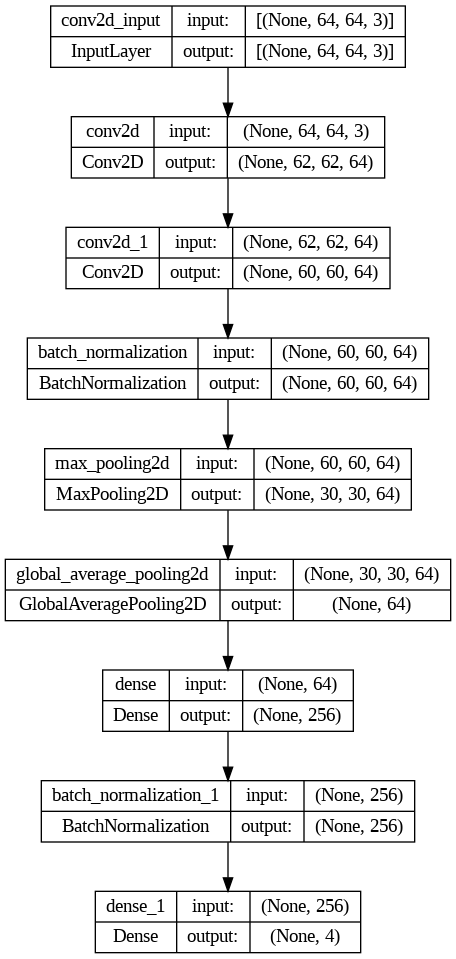

In [ ]:
plot_model(model, to_file = 'model_structure_plot.png', show_shapes = True, show_layer_names = True)

## **Compile & Train the Model**


Now let's start the training. We also need to complile the model.


In [ ]:
# Adding the Early Stopping Callback to the model which will continuously monitor the validation loss metric for every epoch.
# If the models validation loss does not decrease after 15 consecutive epochs, the training will be stopped and the weight which reported the lowest validation loss will be retored in the model.
early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 15, mode = 'min', restore_best_weights = True)

# Adding loss, optimizer and metrics values to the model.
model.compile(loss = 'categorical_crossentropy', optimizer = 'Adam', metrics = ["accuracy"])

# Start Training
model_training_history = model.fit(x = features_train, y = labels_train, epochs = 50, batch_size = 4 , shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback])

Epoch 1/50
5120/5120 [==============================] - 187s 36ms/step - loss: 0.9001 - accuracy: 0.6361 - val_loss: 1.3103 - val_accuracy: 0.6057
Epoch 2/50
5120/5120 [==============================] - 175s 34ms/step - loss: 0.5338 - accuracy: 0.8021 - val_loss: 1.0757 - val_accuracy: 0.7148
Epoch 3/50
5120/5120 [==============================] - 174s 34ms/step - loss: 0.3852 - accuracy: 0.8633 - val_loss: 0.1651 - val_accuracy: 0.9449
Epoch 4/50
5120/5120 [==============================] - 175s 34ms/step - loss: 0.3020 - accuracy: 0.8949 - val_loss: 0.5421 - val_accuracy: 0.8768
Epoch 5/50
5120/5120 [==============================] - 184s 36ms/step - loss: 0.2665 - accuracy: 0.9100 - val_loss: 0.2741 - val_accuracy: 0.9264
Epoch 6/50
5120/5120 [==============================] - 207s 40ms/step - loss: 0.2373 - accuracy: 0.9216 - val_loss: 0.2068 - val_accuracy: 0.9611
Epoch 7/50
5120/5120 [==============================] - 174s 34ms/step - loss: 0.2313 - accuracy: 0.9263 - val_loss: 0

**Install Weights & Biases**

In [ ]:
pip install wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 281.1/281.1 kB 29.5 MB/s eta 0:00:00


In [ ]:
import wandb
from wandb.integration.keras import WandbCallback

# Initialize a new run
wandb.init(project="video_classification", entity="sureshravuri")

# Optionally, you can add configuration that makes it easy to tweak parameters
config = wandb.config
config.learning_rate = 0.001

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


# **Explanation**:

**W&B Run Configuration**: These lines set up configuration parameters for the Weights & Biases (W&B) run.

**Batch Size**: config.batch_size = 4 specifies that each batch will contain 4 samples.

**Epochs**: config.epochs = 50 sets the number of epochs for training to 50.
Validation Split: config.validation_split = 0.2 reserves 20% of the training data for validation.

**Optimizer**: config.optimizer = "Adam" selects the Adam optimizer, which is widely used for its adaptive learning rate properties.
Loss Function: config.loss = "categorical_crossentropy" sets the loss function to categorical cross-entropy, which is suitable for multi-class classification problems.

**Metrics**: config.metrics = ["accuracy"] sets accuracy as the metric to monitor during training.
Patience: config.patience = 15 specifies the number of epochs with no improvement in validation loss after which training will be stopped.
Early Stopping Callback
python
Copy code
# Define the early stopping callback
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=config.patience, mode='min', restore_best_weights=True)
Explanation:

**Early Stopping:** This callback monitors the validation loss (val_loss). If the validation loss does not improve for a number of epochs specified by patience (15 in this case), training will stop early.
Monitor: monitor='val_loss' sets the monitored quantity to validation loss.
Mode: mode='min' means training will stop when the monitored quantity has stopped decreasing.
Restore Best Weights: restore_best_weights=True ensures that the model weights are reverted to the best observed during training, preventing overfitting.
Reason for Using Validation Loss:

**Generalization**: Validation loss is a measure of how well the model performs on unseen data. Monitoring validation loss helps in ensuring that the model generalizes well and does not overfit to the training data.
Model Compilation
python
Copy code
# Compile the model
model.compile(loss=config.loss, optimizer=config.optimizer, metrics=config.metrics)

Explanation:

Compile: This step configures the model for training.
Loss: loss=config.loss sets the loss function to categorical cross-entropy, suitable for classification tasks.
Optimizer: optimizer=config.optimizer uses the Adam optimizer for its efficiency and adaptive learning rates.
Metrics: metrics=config.metrics specifies that accuracy will be tracked during training and evaluation.
Model Training
python
Copy code
# Start training

Explanation:

fit Method: This method trains the model.
Training Data: x=features_train and y=labels_train are the input features and corresponding labels for training.
Epochs: epochs=config.epochs sets the number of epochs for training.
Batch Size: batch_size=config.batch_size sets the number of samples per batch.
Shuffle: shuffle=True ensures that the data is shuffled before each epoch to improve training robustness.
Validation Split: validation_split=config.validation_split reserves a portion of the training data for validation.
Callbacks: callbacks=[early_stopping_callback, WandbCallback()] adds early stopping and Weights & Biases callbacks to the training process. The WandbCallback integrates the training process with W&B for monitoring and logging.
Finishing the W&B Run
python
Copy code
# Finish the W&B run
wandb.finish()

Explanation:

W&B Run Completion: wandb.finish() finalizes the W&B run, ensuring that all the logged data is properly saved and the run is concluded.

**Summary:**

Configuration: Set up the training parameters and model configuration.
Early Stopping: Use validation loss to monitor and prevent overfitting, stopping early if the validation loss does not improve.
Compilation: Configure the model with the specified loss function, optimizer, and metrics.
Training: Train the model with the provided data, using early stopping and W&B for monitoring.
Completion: Finalize the W&B run, ensuring all training data and metrics are saved.
This detailed explanation covers each part of the code and the reasoning behind the choices made for early stopping and other configurations.

In [ ]:
# Configure your W&B run
config = wandb.config
config.batch_size = 4
config.epochs = 50
config.validation_split = 0.2
config.optimizer = "Adam"
config.loss = "categorical_crossentropy"
config.metrics = ["accuracy"]
config.patience = 15

# Define the early stopping callback
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=config.patience, mode='min', restore_best_weights=True)

# Compile the model
model.compile(loss=config.loss, optimizer=config.optimizer, metrics=config.metrics)

# Start training
model_training_history = model.fit(
    x=features_train,
    y=labels_train,
    epochs=config.epochs,
    batch_size=config.batch_size,
    shuffle=True,
    validation_split=config.validation_split,
    callbacks=[early_stopping_callback, WandbCallback()]  # Add WandbCallback here
)

# Finish the W&B run
wandb.finish()

wandb: WARNING The save_model argument by default saves the model in the HDF5 format that cannot save custom objects like subclassed models and custom layers. This behavior will be deprecated in a future release in favor of the SavedModel format. Meanwhile, the HDF5 model is saved as W&B files and the SavedModel as W&B Artifacts.


Epoch 1/50
5119/5120 [============================>.] - ETA: 0s - loss: 0.0984 - accuracy: 0.9713

  saving_api.save_model(

wandb: Adding directory to artifact (/content/wandb/run-20240520_233956-jeg0uuts/files/model-best)... Done. 0.0s


5120/5120 [==============================] - 184s 36ms/step - loss: 0.0984 - accuracy: 0.9713 - val_loss: 0.0908 - val_accuracy: 0.9842
Epoch 2/50
5119/5120 [============================>.] - ETA: 0s - loss: 0.0948 - accuracy: 0.9714

  saving_api.save_model(

wandb: Adding directory to artifact (/content/wandb/run-20240520_233956-jeg0uuts/files/model-best)... Done. 0.0s


5120/5120 [==============================] - 180s 35ms/step - loss: 0.0948 - accuracy: 0.9714 - val_loss: 0.0503 - val_accuracy: 0.9908
Epoch 3/50
5119/5120 [============================>.] - ETA: 0s - loss: 0.0955 - accuracy: 0.9717

  saving_api.save_model(

wandb: Adding directory to artifact (/content/wandb/run-20240520_233956-jeg0uuts/files/model-best)... Done. 0.0s


5120/5120 [==============================] - 177s 35ms/step - loss: 0.0954 - accuracy: 0.9717 - val_loss: 0.0253 - val_accuracy: 0.9934
Epoch 4/50
5120/5120 [==============================] - 182s 35ms/step - loss: 0.0901 - accuracy: 0.9724 - val_loss: 0.0288 - val_accuracy: 0.9941
Epoch 5/50
5120/5120 [==============================] - 176s 34ms/step - loss: 0.0957 - accuracy: 0.9722 - val_loss: 0.0667 - val_accuracy: 0.9865
Epoch 6/50
5119/5120 [============================>.] - ETA: 0s - loss: 0.0939 - accuracy: 0.9707

  saving_api.save_model(

wandb: Adding directory to artifact (/content/wandb/run-20240520_233956-jeg0uuts/files/model-best)... Done. 0.0s


5120/5120 [==============================] - 178s 35ms/step - loss: 0.0939 - accuracy: 0.9708 - val_loss: 0.0207 - val_accuracy: 0.9965
Epoch 7/50
5120/5120 [==============================] - 178s 35ms/step - loss: 0.1030 - accuracy: 0.9698 - val_loss: 0.0631 - val_accuracy: 0.9836
Epoch 8/50
5120/5120 [==============================] - 176s 34ms/step - loss: 0.0804 - accuracy: 0.9758 - val_loss: 0.1912 - val_accuracy: 0.9711
Epoch 9/50
5120/5120 [==============================] - ETA: 0s - loss: 0.0944 - accuracy: 0.9722

  saving_api.save_model(

wandb: Adding directory to artifact (/content/wandb/run-20240520_233956-jeg0uuts/files/model-best)... Done. 0.0s


5120/5120 [==============================] - 180s 35ms/step - loss: 0.0944 - accuracy: 0.9722 - val_loss: 0.0185 - val_accuracy: 0.9936
Epoch 10/50
5119/5120 [============================>.] - ETA: 0s - loss: 0.0911 - accuracy: 0.9726

  saving_api.save_model(

wandb: Adding directory to artifact (/content/wandb/run-20240520_233956-jeg0uuts/files/model-best)... Done. 0.0s


5120/5120 [==============================] - 180s 35ms/step - loss: 0.0911 - accuracy: 0.9725 - val_loss: 0.0168 - val_accuracy: 0.9971
Epoch 11/50
5119/5120 [============================>.] - ETA: 0s - loss: 0.0852 - accuracy: 0.9746

  saving_api.save_model(

wandb: Adding directory to artifact (/content/wandb/run-20240520_233956-jeg0uuts/files/model-best)... Done. 0.0s


5120/5120 [==============================] - 181s 35ms/step - loss: 0.0852 - accuracy: 0.9746 - val_loss: 0.0159 - val_accuracy: 0.9957
Epoch 12/50
5120/5120 [==============================] - 181s 35ms/step - loss: 0.0919 - accuracy: 0.9732 - val_loss: 0.0293 - val_accuracy: 0.9930
Epoch 13/50
5120/5120 [==============================] - 181s 35ms/step - loss: 0.0905 - accuracy: 0.9737 - val_loss: 0.0239 - val_accuracy: 0.9951
Epoch 14/50
5120/5120 [==============================] - 179s 35ms/step - loss: 0.0837 - accuracy: 0.9762 - val_loss: 0.1049 - val_accuracy: 0.9797
Epoch 15/50
5120/5120 [==============================] - 179s 35ms/step - loss: 0.0935 - accuracy: 0.9713 - val_loss: 0.0353 - val_accuracy: 0.9918
Epoch 16/50
5120/5120 [==============================] - 179s 35ms/step - loss: 0.0847 - accuracy: 0.9752 - val_loss: 0.0576 - val_accuracy: 0.9922
Epoch 17/50
5120/5120 [==============================] - 178s 35ms/step - loss: 0.0869 - accuracy: 0.9746 - val_loss: 0.0209

accuracy,▂▂▃▃▃▂▁▆▃▃▅▄▄▇▂▆▅▇▄▅▇▅▆▆▅█
epoch,▁▁▂▂▂▂▃▃▃▄▄▄▄▅▅▅▅▆▆▆▇▇▇▇██
loss,▇▆▆▄▆▅█▂▆▅▃▅▄▂▅▃▃▁▃▃▁▃▁▂▂▁
val_accuracy,▅▆▇▇▅█▄▁▇██▇▇▃▇▇▇▅▆▇█▄▇▇█▆
val_loss,▄▂▁▂▃▁▃█▁▁▁▂▁▅▂▃▁▃▃▅▂▃▃▁▂▂
accuracy,0.97778
best_epoch,10
best_val_loss,0.01591
epoch,25
loss,0.07859
val_accuracy,0.99063


In [ ]:
!pip install mlflow

In [ ]:
import mlflow
import mlflow.keras
import mlflow.sklearn
from urllib.parse import urlparse
import logging

logging.basicConfig(level=logging.WARN)
logger = logging.getLogger(__name__)

In [ ]:
!pip install pyngrok

In [ ]:
from sklearn import metrics
# Adding the Early Stopping Callback to the model which will continuously monitor the validation loss metric for every epoch.
# If the models validation loss does not decrease after 15 consecutive epochs, the training will be stopped and the weight which reported the lowest validation loss will be retored in the model.
with mlflow.start_run():
  early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 15, mode = 'min', restore_best_weights = True)

  # Adding loss, optimizer and metrics values to the model.
  model.compile(loss = 'categorical_crossentropy', optimizer = 'Adam', metrics = ["accuracy","AUC","Precision","Recall"
    ])

  # Start Training
  model_training_history = model.fit(x = features_train, y = labels_train, epochs = 2, batch_size = 4 , shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback])
  mlflow.log_param("accuracy", model_training_history.history['accuracy'])
  mlflow.log_param("auc", model_training_history.history['auc'])
  mlflow.log_param("precision", model_training_history.history['precision'])
  mlflow.log_param("recall", model_training_history.history['recall'])
  get_ipython().system_raw("mlflow ui --port 5000 &") # run tracking UI in the background


# create remote tunnel using ngrok.com to allow local port access
# borrowed from https://colab.research.google.com/github/alfozan/MLflow-GBRT-demo/blob/master/MLflow-GBRT-demo.ipynb#scrollTo=4h3bKHMYUIG6
  tracking_url_type_store = urlparse(mlflow.get_tracking_uri()).scheme
  if tracking_url_type_store != "file":

            # Register the model
            # There are other ways to use the Model Registry, which depends on the use case,
            # please refer to the doc for more information:
            # https://mlflow.org/docs/latest/model-registry.html#api-workflow
      mlflow.sklearn.log_model(model_training_history, "model", registered_model_name="VideoClassificationModel")
  else:
      mlflow.sklearn.log_model(model_training_history, "model")
  from pyngrok import ngrok

  # Terminate open tunnels if exist
  ngrok.kill()

  # Setting the authtoken (optional)
  # Get your authtoken from https://dashboard.ngrok.com/auth
  NGROK_AUTH_TOKEN = ""
  ngrok.set_auth_token('2gjHvsd5ZP31PLL1wQKGYW7NawB_2KgRBY7xUeshzTBpcxTT1')

  # Open an HTTPs tunnel on port 5000 for http://localhost:5000
  ngrok_tunnel = ngrok.connect(addr="5000", proto="http", bind_tls=True)
  print("MLflow Tracking UI:", ngrok_tunnel.public_url)
  tracking_url_type_store = urlparse(mlflow.get_tracking_uri()).scheme

        # Model registry does not work with file store



Epoch 1/2
5120/5120 [==============================] - 144s 28ms/step - loss: 0.8563 - accuracy: 0.6578 - auc: 0.8746 - precision: 0.7351 - recall: 0.5590 - val_loss: 1.0255 - val_accuracy: 0.6297 - val_auc: 0.9001 - val_precision: 0.6322 - val_recall: 0.6219
Epoch 2/2
5120/5120 [==============================] - 140s 27ms/step - loss: 0.5059 - accuracy: 0.8166 - auc: 0.9562 - precision: 0.8487 - recall: 0.7815 - val_loss: 0.8243 - val_accuracy: 0.8016 - val_auc: 0.9382 - val_precision: 0.8080 - val_recall: 0.7922


2024/05/21 10:33:36 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
2024/05/21 10:33:43 WARNING mlflow.utils.requirements_utils: Found jaxlib version (0.4.26+cuda12.cudnn89) contains a local version label (+cuda12.cudnn89). MLflow logged a pip requirement for this package as 'jaxlib==0.4.26' without the local version label to make it installable from PyPI. To specify pip requirements containing local version labels, please use `conda_env` or `pip_requirements`.
  warnings.warn("Setuptools is replacing distutils.")



MLflow Tracking UI: https://b357-34-141-130-89.ngrok-free.app


### **Evaluating Your Trained Model**
Evaluate your trained model on the feature's and label's test sets.

In [ ]:
model_evaluation_history = model.evaluate(features_test, labels_test)

200/200 [==============================] - 8s 38ms/step - loss: 0.9561 - accuracy: 0.8002 - auc: 0.9370 - precision: 0.8093 - recall: 0.7905


### **Save Your Model**
You should now save your model for future runs.

In [ ]:
import datetime as dt

# Creating a useful name for our model, in case you're saving multiple models
date_time_format = '%Y_%m_%d__%H_%M_%S'
current_date_time_dt = dt.datetime.now()
current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)

# Assuming model_evaluation_history is from model.evaluate()
# Example: model_evaluation_history = model.evaluate(x_test, y_test)
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history[:2]

model_name = f'Model___Date_Time_{current_date_time_string}___Loss_{model_evaluation_loss}___Accuracy_{model_evaluation_accuracy}.h5'

# Saving your Model
model.save(model_name)

  saving_api.save_model(



## **Plot Model’s Loss & Accuracy Curves**
Let's plot our loss and accuracy curves.

In [ ]:
def plot_metric(metric_name_1, metric_name_2, plot_name):
  # Get Metric values using metric names as identifiers
  metric_value_1 = model_training_history.history[metric_name_1]
  metric_value_2 = model_training_history.history[metric_name_2]

  # Constructing a range object which will be used as time
  epochs = range(len(metric_value_1))

  # Plotting the Graph
  plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
  plt.plot(epochs, metric_value_2, 'red', label = metric_name_2)

  # Adding title to the plot
  plt.title(str(plot_name))

  # Adding legend to the plot
  plt.legend()

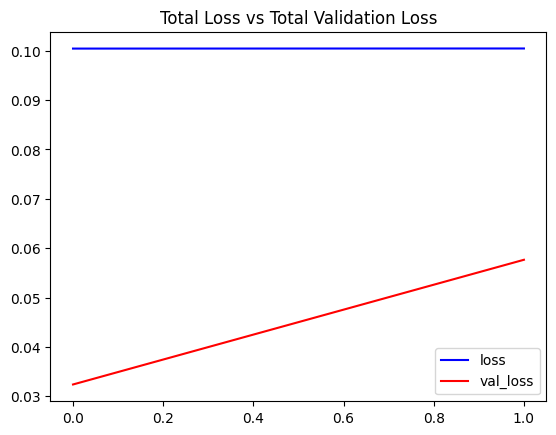

In [ ]:
plot_metric('loss', 'val_loss', 'Total Loss vs Total Validation Loss')

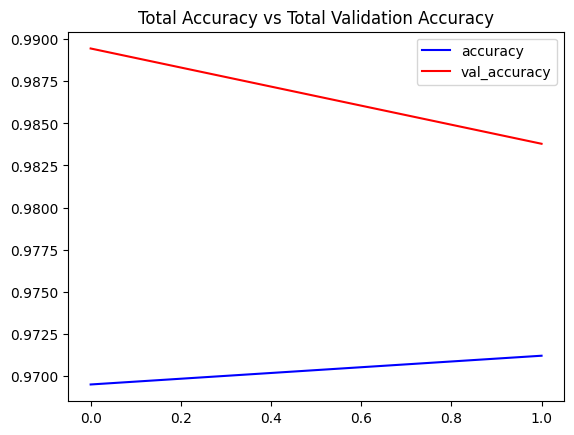

In [ ]:
plot_metric('accuracy', 'val_accuracy', 'Total Accuracy vs Total Validation Accuracy')

## **Make Predictions with the Model:**
Now that we have created and trained our model it's time to test it's performance on some test videos.


#### **Function to Download YouTube Videos:**
Let's start by testing on some youtube videos, this function will use pafy librar to download any youtube video and return it's title. You just need to pass the URL.

In [ ]:
def download_youtube_videos(youtube_video_url, output_directory):
    # Creating a Video object which includes useful information regarding the youtube video.
    video = pafy.new(youtube_video_url)

    # Getting the best available quality object for the youtube video.
    video_best = video.getbest()

    # Constructing the Output File Path
    output_file_path = f'{output_directory}/{video.title}.mp4'

    # Downloading the youtube video at the best available quality.
    video_best.download(filepath = output_file_path, quiet = True)

    # Returning Video Title
    return video.title

#### **Function To Predict on Live Videos Using Moving Average:**
This function will predict on live videos using moving_average, you can either pass in videos saved on disk or use your webcam. If you set `window_size` hyperparameter to `1` then this function will behave like a normal classifier to predict on video frames.

In [ ]:
def predict_on_live_video(video_file_path, output_file_path, window_size):

    # Initialize a Deque Object with a fixed size which will be used to implement moving/rolling average functionality.
    predicted_labels_probabilities_deque = deque(maxlen = window_size)

    # Reading the Video File using the VideoCapture Object
    video_reader = cv2.VideoCapture(video_file_path)

    # Getting the width and height of the video
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Writing the Overlayed Video Files Using the VideoWriter Object
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('M', 'P', '4', 'V'), 24, (original_video_width, original_video_height))

    while True:

        # Reading The Frame
        status, frame = video_reader.read()

        if not status:
            break

        # Resize the Frame to fixed Dimensions
        resized_frame = cv2.resize(frame, (image_height, image_width))

        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1
        normalized_frame = resized_frame / 255

        # Passing the Image Normalized Frame to the model and receiving Predicted Probabilities.
        predicted_labels_probabilities = model.predict(np.expand_dims(normalized_frame, axis = 0))[0]

        # Appending predicted label probabilities to the deque object
        predicted_labels_probabilities_deque.append(predicted_labels_probabilities)

        # Assuring that the Deque is completely filled before starting the averaging process
        if len(predicted_labels_probabilities_deque) == window_size:

            # Converting Predicted Labels Probabilities Deque into Numpy array
            predicted_labels_probabilities_np = np.array(predicted_labels_probabilities_deque)

            # Calculating Average of Predicted Labels Probabilities Column Wise
            predicted_labels_probabilities_averaged = predicted_labels_probabilities_np.mean(axis = 0)

            # Converting the predicted probabilities into labels by returning the index of the maximum value.
            predicted_label = np.argmax(predicted_labels_probabilities_averaged)

            # Accessing The Class Name using predicted label.
            predicted_class_name = classes_list[predicted_label]

            # Overlaying Class Name Text Ontop of the Frame
            # cv2.putText(frame, predicted_class_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

        # Writing The Frame
        # video_writer.write(frame)
        print('Predicted Action: ', predicted_class_name)
        break

        # cv2.imshow('Predicted Frames', frame)

        # key_pressed = cv2.waitKey(10)

        # if key_pressed == ord('q'):
        #     break

    # cv2.destroyAllWindows()


    # Closing the VideoCapture and VideoWriter objects and releasing all resources held by them.
    # video_reader.release()
    # video_writer.release()

#### **Results Without Using Moving Average:**
First let's see the results when we're not using moving average, we can do this by setting the `window_size` to `1`.

Load Test Videos

In [ ]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [ ]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os

# Change this path to the directory you want to inspect
directory_path = '/content/drive/My Drive/final258/'

# Listing the contents of the directory
print(os.listdir(directory_path))

['Trained_Model_CNN.h5', 'video_1.mp4', 'video_2.mp4', 'test_video.mp4']


In [ ]:
from moviepy.editor import VideoFileClip

# Setting the Window Size which will be used by the Rolling Average Process
window_size = 1

# Correcting the directory in the paths
input_video_file_path = '/content/drive/My Drive/final258/video_1.mp4'  # Adjusted path
output_video_file_path = '/content/drive/My Drive/final258/output1.mp4'  # Adjusted path

# Calling the predict_on_live_video method to start the Prediction
predict_on_live_video(input_video_file_path, output_video_file_path, window_size)

# Play Video File in the Notebook
VideoFileClip(input_video_file_path).ipython_display(width=700)

1/1 [==============================] - 0s 27ms/step
Predicted Action:  WalkingWithDog
Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



t:  97%|█████████▋| 1408/1451 [00:02<00:00, 519.31it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file /content/drive/My Drive/final258/video_1.mp4, 691200 bytes wanted but 0 bytes read,at frame 1449/1451, at time 57.96/58.03 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## **Using Single-Frame CNN Method:**
Now let's create a function that will output a singular prediction for the complete video, now this function will take `n` frames from the entire video and make predictions. In the end, it will average the predictions of those <code>n</code> frames to give you the final activity class for that video. You can set the value of <code>n</code> using the <code>predictions_frames_count</code> variable.

This function is useful when you have a video containing one activity and you want to know the activity's name and its score.


In [ ]:
def make_average_predictions(video_file_path, predictions_frames_count):

    # Initializing the Numpy array which will store Prediction Probabilities
    predicted_labels_probabilities_np = np.zeros((predictions_frames_count, model_output_size), dtype = np.float64)

    # Reading the Video File using the VideoCapture Object
    video_reader = cv2.VideoCapture(video_file_path)

    # Getting The Total Frames present in the video
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculating The Number of Frames to skip Before reading a frame
    skip_frames_window = video_frames_count // predictions_frames_count

    for frame_counter in range(predictions_frames_count):

        # Setting Frame Position
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        # Reading The Frame
        _ , frame = video_reader.read()

        # Resize the Frame to fixed Dimensions
        resized_frame = cv2.resize(frame, (image_height, image_width))

        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1
        normalized_frame = resized_frame / 255

        # Passing the Image Normalized Frame to the model and receiving Predicted Probabilities.
        predicted_labels_probabilities = model.predict(np.expand_dims(normalized_frame, axis = 0))[0]

        # Appending predicted label probabilities to the deque object
        predicted_labels_probabilities_np[frame_counter] = predicted_labels_probabilities

    # Calculating Average of Predicted Labels Probabilities Column Wise
    predicted_labels_probabilities_averaged = predicted_labels_probabilities_np.mean(axis = 0)

    # Sorting the Averaged Predicted Labels Probabilities
    predicted_labels_probabilities_averaged_sorted_indexes = np.argsort(predicted_labels_probabilities_averaged)[::-1]

    # Iterating Over All Averaged Predicted Label Probabilities
    for predicted_label in predicted_labels_probabilities_averaged_sorted_indexes:

        # Accessing The Class Name using predicted label.
        predicted_class_name = classes_list[predicted_label]

        # Accessing The Averaged Probability using predicted label.
        predicted_probability = predicted_labels_probabilities_averaged[predicted_label]

        print(f"CLASS NAME: {predicted_class_name}   AVERAGED PROBABILITY: {(predicted_probability*100):.2}")

    # Closing the VideoCapture Object and releasing all resources held by it.
    video_reader.release()

#### **Test Average Prediction Method On Youtube Videos:**

In [ ]:
# Downloading The YouTube Video
input_video_file_path = '/content/drive/My Drive/final258/video_2.mp4'

# Calling The Make Average Method To Start The Process
make_average_predictions(input_video_file_path, 50)

# Play Video File in the Notebook
VideoFileClip(input_video_file_path).ipython_display(width = 700, maxduration=300)

1/1 [==============================] - 0s 26ms/step
CLASS NAME: WalkingWithDog   AVERAGED PROBABILITY: 4.7e+01
CLASS NAME: Swing   AVERAGED PROBABILITY: 2.9e+01
CLASS NAME: TaiChi   AVERAGED PROBABILITY: 2.2e+01
CLASS NAME: HorseRace   AVERAGED PROBABILITY: 1.6
Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
# Downloading The YouTube Video
input_video_file_path = '/content/drive/MyDrive/final258/test_video.mp4'

# Calling The Make Average Method To Start The Process
make_average_predictions(input_video_file_path, 50)

# Play Video File in the Notebook
VideoFileClip(input_video_file_path).ipython_display(width = 700, maxduration=300)

NameError: name 'make_average_predictions' is not defined

In [ ]:
# Downloading The YouTube Video
input_video_file_path = '/content/drive/My Drive/final258/TRY.mp4'

# Calling The Make Average Method To Start The Process
make_average_predictions(input_video_file_path, 50)

# Play Video File in the Notebook
VideoFileClip(input_video_file_path).ipython_display(width = 700, maxduration=300)

1/1 [==============================] - 0s 25ms/step
CLASS NAME: WalkingWithDog   AVERAGED PROBABILITY: 4e+01
CLASS NAME: Swing   AVERAGED PROBABILITY: 3.3e+01
CLASS NAME: HorseRace   AVERAGED PROBABILITY: 2.6e+01
CLASS NAME: TaiChi   AVERAGED PROBABILITY: 0.081
Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
